# <font color='blue'>ASTR 21100</font>

# <font color='blue'>"*Computational Techniques in Astrophysics*"</font>

## <font color='blue'>a final project option</font>

### <font color='blue'> Supervised and unspervised learning:</font> 
    
### <font color='blue'> Morphological classification of galaxies using supervised machine learning methods ($k$-means, GMM, k-th nearest neighbors (KNN), Randomized Forest, and neural networks)</font>

#### <font color='blue'>50 points + possible extra credit points</font>


### <font color='black'>Primary instructor(s) for this project: Andrey Kravtsov </font>
    
    

<p>
<p>
<center>
<img width=600 src="https://astro.uchicago.edu/~andrey/classes/a211/img/i_heart_galaxies.PNG"></img>

### <font color='blue'>Background</font>

    
Morphological classification (classification by visual appearance) is an old and frequently used approach in astronomy. Morphological classification of galaxies has been particularly widely used with the scheme developed by Edwin Hubble during his PhD studies at U.Chicago being the most widely used (see, for example, <a href="https://jila.colorado.edu/~pja/astr3830/lecture10.pdf">here</a> for a concise description). 
    
    
<p>
<center>
<img width=700 src="https://www.researchgate.net/profile/Yin-Cui-2/publication/269299953/figure/fig2/AS:644316393402372@1530628407895/The-Hubble-Sequence.png"></img>
    
Hubble arranged his morphological classes into what's called the "tuning fork" diagram thinking that it represented evolutionary sequence from spheroidal galaxies (on the left in the diagram above) to the spiral galaxies on the right. This evolutionary thinking is still reflected in the terms "early type" and "late type" galaxies, even though subsequent studies did not support Hubble's vision for how evolution proceeds. In fact, current models predict that some spiral galaxies evolve into spheroidal galaxies (our Milky Way will do this in a few billion years after it merges with Andromeda galaxy), but the opposite almost never happens. Moreover, not all spiral galaxies will evolve into spheroidals. 
    
Nevertheless, observations of morphological class frequency and its evolution with time provides a very useful window into how galaxies form. For example, one of the most exciting results from the early observations by the James Webb Space Telescope (JWST) in 2022 was a somewhat surprising prevalence of spiral/disk galaxies at high redshifts. 
    

The are two frequently encountered issues with morphological classification:
    
    
* It is subjective and classification by different scientists may result in different classifications for borderline cases.
       
* It is difficult or impossible to visually classify hundreds of thousand or millions of galaxies in modern surveys. 
    
    
The first issue can be mitigated if master classification for a certain set of galaxies is done by several trained expert astronomers. Results of such multiple classification can be averaged. 
    
Alternatively, classification can be done by amateurs or even people with little knowledge of astronomy (but a lot of enthusiasm for it), but with many people classifying each image. Correct results for a given image can then be estimated from statistics of multiple classifications.  
    
    
Regardless of how reliable classification is obtained for a set of galaxies, it can then be used as a training set to train a machine learning algorithm, which can then be used to classify a large number of new images with accuracy comparable to the original classification in the training set. 
    

In this project you will undertake this latter step using some supervised and unsupervised machine learning methods. 

### <font color='blue'>Which computational and analysis methods are used in this project</font>

    
* General application of machine learning methods (such as $k$-means, SVM, Random Forest) for classification
 
    
* Validation of machine learning results and measuring their accuracy.
    
    
* Plotting in 2d (and possibly in 3D) and image gallery.  

### <font color='blue'>Preparatory steps</font>

* Review material on machine learning methods covered in class in the <a href="https://drive.google.com/file/d/12yV_4UFa9ukNw82gzndg1kO-6SaCNAB1/view?usp=sharing">10_ml_intro</a>, in particular about $k^{\rm th}$-nearest neighbor (knn), SVM, and Randomized Forest methods.

    
* Also, review material in <a href="https://drive.google.com/file/d/1ucj1cERVOrII46tNK5CEiPRSXTDe7R3o/view?usp=drive_link">ML_in_action notebook</a>, which illustrates use of the ML methods for classification of sources as galaxies, stars, or quasars using real data from SDSS catalog. This notebook discusses data examination, feature importance analysis, testing, validation, confusion matrix, etc, which you will need in this project. 
    
    
* Familiarize yourself with the <a href="https://scikit-learn.org/stable/index.html">sci-kit learn</a> Python library containing Python implementing many machine learning methods. In particular, examine functions available for  <a href="https://scikit-learn.org/stable/modules/neighbors.html">KNN</a>, <a href="https://scikit-learn.org/stable/modules/classes.html#module-sklearn.svm">SVM</a>, and <a href="https://scikit-learn.org/stable/modules/classes.html#module-sklearn.ensemble">Randomized Forest methods</a>. For the latter two classes of methods multiple functions are available, which implement different versions of these approaches. 


* Examine galaxy properties obtained from the UPenn catalog of SDSS galaxies (<a href="http://adsabs.harvard.edu/abs/2015MNRAS.446.3943M">Meert et al. 2015</a>). The code reasing the catalog and extracting a number of possible properties that can be used for galaxy classification is provided at the end of this notebook. This catalog also contains probabilities of morphological classes, which can be used to assign morphological class for each object for training. Review the code at the end of this notebook showing how to read the catalog, compute absolute magnitudes and distances to galaxies and access and manipulate morphological probabilities. Make sure you can run this code on your laptop. 
    

## <font color='blue'>Project description</font>


### <font color='blue'>Part 1 (20 points)</font> 

* Review the provided code below and which properties of galaxies are available. 

* Define a galaxy sample for analysis and use galaxy morphological probabilities available in the UPenn SDSS catalog to define a discrete classes for each galaxy, as illustrated in the code below. Construct the following classes and their labels (10 points):
    
    * Classes 1 (relatively fine classification): Sab (spiral types a and b), Scd (spiral types c and d), S0 (lenticular galaxies), and E (elliptical). 
    * Classes 2 (coarser classification): Spiral (spiral combining Sab and Scd), S0 (lenticular), and E (elliptical).  
    * Classes 3 (coarse classification): D (disk galaxies, including Sab, Scd, S0) and E (elliptical).
    * Classes 4: Spiral (Sab and Sab) and Spheroidal (S0+Elliptical) galaxies 
    
    
* Use the [Principle Component Analysis (PCA)](https://builtin.com/data-science/step-step-explanation-principal-component-analysis) and [SelectKBest](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.SelectKBest.html) to explore which properties of galaxies are the most important for classification, as illustrated in the notebook ML_in_action. Select several galaxy properties that will define multi-dimensional space within which algorithms will be identifying clusters/classes (each galaxy property corresponding to one dimension). (10 points)
   

### <font color='blue'>Part 2 (30 points)</font>

* Split the galaxy sample you defined into training and test samples (the training sample should be the largest, test sample should be about $20\%$ of the sample). You can see how such split can be done with scikit-learn <a href="https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html">here</a>. (2 points)


* Run the $k$-means algorithm on your galaxy sample with 2, 3, and 4 clusters to find. Check how well the clusters that the algorithm finds match the three sets of morphological classes assigned based on morphology probabilities in the catalog (Classes 1-3 described above). Discuss how accurate classification is for 2, 3, and 4 clusters. (3 points)
* 

* Run the GMM algorithm with 2 and more components. Identify the optimal number of components using BIC indicator. Compare the optimal number of components to the potential number of classes (Classes 1-3 above). Test how accurate is the classification based on the GMM using the test sample. (5 points)
    
* Run KNN algorithm on the same subset of parameters as for other methods above.  Evaluate accuracy and confusion matrix and compare results to the $k$-means clustering or GMM algorithms above (depending on which you did). (5 points)


* Run the Random Forest algorithm using your galaxy sample. Compute and print the accuracy of classification and confusion matrix. (3 points)


* Evaluate and plot/print importance of different galaxy properties (features) that you have chosen for classification. Use this information to define a smaller subset of properties that have largest importance. Re-train Random Forest using only these properties, evaluate accuracy, and confusion matrix and compare to previous results. Briefly discuss your results and provide conclusions and your thoughts on these results.  (2 points)

    
* Explore how your results depend on the parameters of the Random Forest method  (<tt>n_estimators</tt> and <tt>min_samples_split</tt> in this case). You can simply try different values, or use scikit-learn function <tt>GridSearchCV</tt>. (5 points)


* Using the same subset of parameters as in the final parts of Part 1 (i.e. after evaluating feature importance and selecting subset of parameters), use examples in the distributed notebook during class to carry out classification using neural network. Plot confusion matrix and discuss how the accuracy and speed of this method compares to the methods above. (5 points). 


    
    
### <font color='blue'>Extra-credit: morphological classification visualization (5 points)</font>
    
Use predictions of your best classifier to predict classes that you identified among the methods in the steps above to predict classes for a random subset of galaxies. Pull images of these galaxies from SDSS server and display them in a thumbnail gallery using example code provided to you. Do this for for different classes of galaxies. 
  
If you decide to do this part, an example code showing how to pull out images from SDSS and display them as a thumbnail gallery is provided at the end of this notebook. 

## <font color='blue'>Data and preparation for classification: UPenn catalog of SDSS galaxies</font>

You will use the <a href="http://www.physics.upenn.edu/~ameert/SDSS_PhotDec/download/">UPenn catalog of SDSS galaxies</a>. This catalog contains improved measurements of photometric properties of galaxies  (<a href="http://adsabs.harvard.edu/abs/2015MNRAS.446.3943M">Meert et al. 2015</a>). The catalog files are available  <a href="https://astro.uchicago.edu/~andrey/classes/a211/data/Meert2015_v2/">here</a>. The code below reads data directly from our department server. You may also download the files to your laptop, and then change the <tt>url</tt> parameter of the function below to the path to a local directory where you stored the catalog files.  

In [2]:
import numpy as np
from timeit import default_timer
import matplotlib.pyplot as plt

# the following code make plots look better
def plot_prettier(dpi=150, fontsize=11, usetex=False): 
    '''
    Make plots look nicer compared to Matplotlib defaults
    Parameters: 
        dpi - int, "dots per inch" - controls resolution of PNG images that are produced
                by Matplotlib
        fontsize - int, font size to use overall
        usetex - bool, whether to use LaTeX to render fonds of axes labels 
                use False if you don't have LaTeX installed on your system
    '''
    plt.rcParams['figure.dpi']= dpi
    plt.rc("savefig", dpi=dpi)
    plt.rc('font', size=fontsize)
    plt.rc('xtick', direction='in') 
    plt.rc('ytick', direction='in')
    plt.rc('xtick.major', pad=5) 
    plt.rc('xtick.minor', pad=5)
    plt.rc('ytick.major', pad=5) 
    plt.rc('ytick.minor', pad=5)
    plt.rc('lines', dotted_pattern = [2., 2.])
    if usetex:
        plt.rc('text', usetex=usetex)
    else:
        plt.rcParams['mathtext.fontset'] = 'cm'
        plt.rcParams['font.family'] = 'serif'
        plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']

plot_prettier()




In [3]:
import matplotlib
def heatmap(data, row_labels, col_labels, ax=None,
            cbar_kw=None, cbarlabel="", **kwargs):
    """
    Create a heatmap from a numpy array and two lists of labels.
    Parameters
    ----------
    data
        A 2D numpy array of shape (M, N).
    row_labels
        A list or array of length M with the labels for the rows.
    col_labels
        A list or array of length N with the labels for the columns.
    ax
        A `matplotlib.axes.Axes` instance to which the heatmap is plotted.  If
        not provided, use current axes or create a new one.  Optional.
    cbar_kw
        A dictionary with arguments to `matplotlib.Figure.colorbar`.  Optional.
    cbarlabel
        The label for the colorbar.  Optional.
    **kwargs
        All other arguments are forwarded to `imshow`.
    """
    if ax is None:
        ax = plt.gca()
    if cbar_kw is None:
        cbar_kw = {}
    # Plot the heatmap
    im = ax.imshow(data, **kwargs)
    # Create colorbar
    #cbar = ax.figure.colorbar(im, ax=ax, **cbar_kw)
    #cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    # Show all ticks and label them with the respective list entries.
    ax.set_xticks(np.arange(data.shape[1]), labels=col_labels)
    ax.set_yticks(np.arange(data.shape[0]), labels=row_labels)
    # Let the horizontal axes labeling appear on top.
    ax.tick_params(top=True, bottom=False,
                   labeltop=True, labelbottom=False)
    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=-30, ha="right",
             rotation_mode="anchor")
    # Turn spines off and create white grid.
    ax.spines[:].set_visible(False)
    ax.set_xticks(np.arange(data.shape[1]+1)-.5, minor=True)
    ax.set_yticks(np.arange(data.shape[0]+1)-.5, minor=True)
    ax.grid(which="minor", color="w", linestyle='-', linewidth=3)
    ax.tick_params(which="minor", bottom=False, left=False)
    return im
def annotate_heatmap(im, data=None, valfmt="{x:.2f}", class_labels=None,
                     textcolors=("black", "white"), ax = None,
                     threshold=None, **textkw):
    """
    A function to annotate a heatmap.
    Parameters
    ----------
    im
        The AxesImage to be labeled.
    data
        Data used to annotate.  If None, the image's data is used.  Optional.
    valfmt
        The format of the annotations inside the heatmap.  This should either
        use the string format method, e.g. "$ {x:.2f}", or be a
        `matplotlib.ticker.Formatter`.  Optional.
    textcolors
        A pair of colors.  The first is used for values below a threshold,
        the second for those above.  Optional.
    threshold
        Value in data units according to which the colors from textcolors are
        applied.  If None (the default) uses the middle of the colormap as
        separation.  Optional.
    **kwargs
        All other arguments are forwarded to each call to `text` used to create
        the text labels.
    """
    if not isinstance(data, (list, np.ndarray)):
        data = im.get_array()
    # Normalize the threshold to the images color range.
    if threshold is not None:
        threshold = im.norm(threshold)
    else:
        threshold = im.norm(data.max())/2.
    # Set default alignment to center, but allow it to be
    # overwritten by textkw.
    kw = dict(horizontalalignment="center",
              verticalalignment="center")
    kw.update(textkw)
    # Get the formatter in case a string is supplied
    if isinstance(valfmt, str):
        valfmt = matplotlib.ticker.StrMethodFormatter(valfmt)
    # Loop over data dimensions and create text annotations.
    for i in range(len(class_labels)):
        for j in range(len(class_labels)):
            text = ax.text(j, i, f'{data[i,j]:.3f}',
                           ha="center", va="center", color="orange")

In [4]:
def read_meert_catalog(phot_type=None, 
                       url = r'https://astro.uchicago.edu/~andrey/classes/a211/data/Meert2015_v2/'
):
    """Loader for the Meert et al. 2015 catalog of improved photometric measurements
    for galaxies in the SDSS DR7 main galaxy catalog 
    input: phot_type - integer corresponding to the photometry model fit type from the catalog
        1=best fit, 2=deVaucouleurs, 3=Sersic, 4=DeVExp, 5=SerExp
    returns combined structured array with all the data
    """
    from astropy.io import fits


    if (phot_type < 1) or (phot_type > 5):
        raise Exception('unsupported type of Meert et al. photometry: %d, choose number between 1 and 5')

    # change datadir to the directory where UPenn catalog is located
    datameertnonpar = url + r'UPenn_PhotDec_nonParam_rband.fits'
    datameertnonparg = url + r'UPenn_PhotDec_nonParam_gband.fits'
    datameert = url + r'UPenn_PhotDec_Models_rband.fits'
    datasdss = url + r'UPenn_PhotDec_CAST.fits'
    datasdssmodels = url + r'UPenn_PhotDec_CASTmodels.fits'
    datameertg = url + r'UPenn_PhotDec_Models_gband.fits'
    datameerti = url + r'UPenn_PhotDec_Models_iband.fits'
    datamorph = url + r'UPenn_PhotDec_H2011.fits' # morphology probabilities from Huertas-Company et al. 2011

    # mdata tables: 1=best fit, 2=deVaucouleurs, 3=Sersic, 4=DeVExp, 5=SerExp
    mdata = fits.open(datameert)[phot_type].data
    mdatag = fits.open(datameertg)[phot_type].data
    mdatai = fits.open(datameerti)[phot_type].data
    mnpdata = fits.open(datameertnonpar)[1].data
    mnpdatag = fits.open(datameertnonparg)[1].data
    sdata = fits.open(datasdss)[1].data
    phot_r = fits.open(datasdssmodels)[1].data
    morph = fits.open(datamorph)[1].data

    # eliminate galaxies with bad photometry
    fflag = mdata['finalflag']
    print("%d galaxies in Meert et al. sample initially"%(np.size(fflag)))

    def isset(flag, bit):
        """Return True if the specified bit is set in the given bit mask"""
        return (flag & (1 << bit)) != 0
        
    # use minimal quality cuts and flags recommended by Alan Meert
    igood = ((phot_r['petroMag'] > 0.) & (phot_r['petroMag'] < 100.) & (mnpdata['kcorr'] > 0) &
             (mdata['m_tot'] > 0) & (mdata['m_tot'] < 100) &
             (isset(fflag, 1) | isset(fflag, 4) | isset(fflag, 10) | isset(fflag, 14)))

    sdata = sdata[igood]; phot_r = phot_r[igood]; mdata = mdata[igood]
    mnpdata = mnpdata[igood]; mdatag = mdatag[igood]; 
    mnpdatag = mnpdatag[igood]; morph = morph[igood]
    mdatai = mdatai[igood]
    return sdata, mdata, mnpdata, phot_r, mdatag, mnpdatag, morph, mdatai


The next cell will a large piece of data over internet, so this may take a while... 

In [5]:
# read fits tables from the Meert et al. catalog
# input phot_type selects photometry model fit:  1=best fit, 2=deVaucouleurs, 3=Sersic, 4=DeVExp, 5=SerExp

meert_data = read_meert_catalog(phot_type=3)

670722 galaxies in Meert et al. sample initially


Here is how you can check the fields contained in the data tables. You can cross-reference these variable names with the info in the <tt>data_tables.pdf</tt> file in the catalog subdirectory. 

In [6]:
# read function actually returned a list of tables, let's split them
sdata, mdata, mnpdata, phot_r, mdatag, mnpdatag, mrph, mdatai = meert_data

print(sdata.names)
print(mdata.names)
# for t in meert_data: 
#     print (t.names)

['galcount', 'objid', 'SDSSIAU', 'badflag', 'nchild', 'mode', 'run', 'rerun', 'camCol', 'field', 'obj', 'stripe', 'startmu', 'specobjid', 'plate', 'mjd', 'fiberid', 'ra', 'dec', 'z', 'veldisp', 'veldispErr', 'eclass', 'p_el_debiased', 'p_cs_debiased', 'spiral', 'elliptical', 'uncertain']
['m_tot', 'm_aper', 'BT', 'r_tot', 'ba_tot', 'BT_aper', 'xctr_bulge', 'xctr_bulge_err', 'yctr_bulge', 'yctr_bulge_err', 'm_bulge', 'm_bulge_err', 'r_bulge', 'r_bulge_err', 'n_bulge', 'n_bulge_err', 'ba_bulge', 'ba_bulge_err', 'pa_bulge', 'pa_bulge_err', 'xctr_disk', 'xctr_disk_err', 'yctr_disk', 'yctr_disk_err', 'm_disk', 'm_disk_err', 'r_disk', 'r_disk_err', 'n_disk', 'n_disk_err', 'ba_disk', 'ba_disk_err', 'pa_disk', 'pa_disk_err', 'GalSky', 'GalSky_err', 'chi2nu', 'finalflag', 'autoflag', 'pyflag', 'pyfitflag']


In [7]:
from astropy.cosmology import LambdaCDM
import astropy.units as u
clight = 2.99792458e5 # c in km/s

def d_l_astropy(z, Om0, OmL):
    # instantiate cosmological model class 
    cosmo = LambdaCDM(H0=70, Om0=Om0, Ode0=OmL) 
    # use luminosity_distance method to compute d_L for z values for this cosmo model
    return cosmo.luminosity_distance(z=z) / u.Mpc 

In [8]:
##### define some limiting parameters for the sample and make the corresponding cuts
z_min = 0.01; z_max = 0.1
m_min = 14.5; m_max = 17.77

# define range of absolute magnitudes
M_min, M_max = -25., -19

# prepare preliminary quantities
# apparent angular size of galaxies and their extinctions
size = phot_r['petroR50']; extm = mnpdata['extinction']

# correct the Petrosian magnitude for extinction
mrm = phot_r['petroMag'] - extm
# compute surface brightnesses in magnitudes per square arcsec
sb50 = mrm - 2.5*np.log10(0.5) + 2.5*np.log10(np.pi*(size)**2) 
# and extinction corrected g-r colors
grm = mdatag['m_tot'] - mdata['m_tot'] - mnpdatag['extinction'] + mnpdata['extinction']
rim = mdata['m_tot'] - mdatai['m_tot'] # r-i color
mmeert = mdata['m_tot'] # improved r-band photometry from Meert et al. 2015

# convert apparent magnitude into absolute magnitude
# luminosity distance in Mpc
zm = sdata['z']
d_l =  d_l_astropy(zm, 0.3, 0.7) 
Mmeert = mmeert - 5.0*np.log10(d_l/1e-5) - extm + 1.3*zm 

# make some cuts to eliminate bad regimes or catastrophic failures
ilim = ((Mmeert > M_min) & (Mmeert < M_max) &( mrm > m_min) & (mrm < m_max) & (zm > z_min) & 
        (zm < z_max) & (sb50 > 0.) & (sb50 <= 25.) & (grm>-0.5) & (grm<2.2))

# galaxy photometry tables
md = mdata[ilim]; phr = phot_r[ilim] 
sd = sdata[ilim]

# morphological information for training
morph = mrph[ilim]

d_Lm = d_l[ilim]

# a bunch of variables that can be used as parameters for classifying galaxies
zm = sd['z'] # redshifts
Mmeert = Mmeert[ilim] # absolute magnitudes
sb50 = sb50[ilim] #  mean surface brightness within half-light radius
grm = grm[ilim] # g-r color
rim = rim[ilim] # r-i color
cr = phr['petroR90']/phr['petroR50'] # concentration of light
nser = md['n_bulge'] # Sersic index
ba = md['ba_tot'] # axis ratio b/a of light
print("selected %d galaxies after all cuts..."%np.size(zm))



selected 181747 galaxies after all cuts...


The code below shows how to access probabilities for each galaxy to have a morphological class of a spheroidal galaxy E (Elliptical or S0), Elliptical, S0, Sa or Sb (Sab), Sc or Sd (Scd). These classes are a simplified version of the <a href="https://en.wikipedia.org/wiki/Hubble_sequence">Hubble's galaxy morphological classification</a> that is widely used in astronomy. 

These morphological type probabilities were assigned to galaxies in the catalog using a training sample of galaxies classifed by "citizen-scientists" (i.e. public) as part of the Galaxy Zoo project and then a machine learning algorithm to assign the probabilities to all galaxies. As part of this project you should be able to reverse engineer which machine learning algorithm was used for this. 

In [9]:
#part 1------------------------------------>

# Bayesian machine learning probabilities of morphological classes from Huertas-Company et al. 2011, AA 525, 157
# probaE is probability to be early type (either E or S0); 1-probaE is probability to be spiral
# probaEll = probability to be elliptical; probaS0 = p(S0); probaSab = p(Sa or Sb); probaScd = p(Sc, Sd, or Irr)

#I need four classes Sab, Scd, S0, and E; Spiral, S0, and E; D(including Sab, Scd and S0) and E; Sab, S0 and E


pEll = morph['probaEll']; pS0  = morph['probaS0']; 
pSab = morph['probaSab']; pScd = morph['probaScd']; 


# morphological class T is a variable that combines these probabilities 
# into a single number that can be used to define classes
# T fit from Meert et al. (2015)
T = (-4.6 * pEll)-(2.4 * pS0) + (2.5*pSab) + (6.1*pScd)

# define filters that will select galaxies of a given morphological type
# this uses morphological type boundaries suggested in Meert et al. 2015
ell = T <= -3
s0 = (0.5 >= T) & (T > -3)
sab = (4 >= T) & (T > 0.5)
scd = T > 4

spiral  = T > 0.5
spheroidal = ~spiral
disk = T > -3

# these filters can now be used to select properties of only galaxies of Elliptical or Spheroidal type
# for example g-r color of elliptical galaxies can be selected as
grm_ell = grm[ell]

# Classes 1 (relatively fine classification): Sab (spiral types a and b), Scd (spiral types c and d), S0 (lenticular galaxies), and E (elliptical).
# Classes 2 (coarser classification): Spiral (spiral combining Sab and Scd), S0 (lenticular), and E (elliptical).
# Classes 3 (coarse classification): D (disk galaxies, including Sab, Scd, S0) and E (elliptical).
# Classes 4: Spiral (Sab and Sab) and Spheroidal (S0+Elliptical) galaxies

#classes 1
labels = np.zeros_like(T).astype('int')
labels[s0]  = 1
labels[sab] = 2
labels[scd] = 3

print(labels)

#classes 2
labels2 = np.zeros_like(T).astype('int')
labels2[spiral]  = 1
labels2[s0] = 2

#classes 3
labels3 = np.zeros_like(T).astype('int')
labels3[disk]  = 1

#classes 4
labels4 = np.zeros_like(T).astype('int')
labels4[spiral]  = 1


# one-hot bit encoding

#classes 1
labels_1h = np.zeros((T.size,4)).astype('int')
labels_1h[ell,0] = 1
labels_1h[s0,1]  = 1
labels_1h[sab,2] = 1
labels_1h[scd,3] = 1

#classes 2
labels_1h2 = np.zeros((T.size,3)).astype('int')
labels_1h2[ell,0] = 1
labels_1h2[spiral,1]  = 1
labels_1h2[s0,2] = 1

#classes 3
labels_1h3 = np.zeros((T.size,2)).astype('int')
labels_1h3[ell,0] = 1
labels_1h3[disk,1]  = 1

#classes 4
labels_1h4 = np.zeros((T.size,2)).astype('int')
labels_1h4[spheroidal,0] = 1
labels_1h4[spiral,1]  = 1


[2 3 3 ... 2 2 2]


In [9]:
n_feat = 7

# initialize feature matrix
X_feat = np.zeros([T.size,n_feat])


# define feature matrix
for i, f in enumerate([Mmeert, sb50, grm, rim, cr, nser, ba]):
    X_feat[:,i] = f

In [10]:
from sklearn.preprocessing import StandardScaler

X_ft_stand = StandardScaler().fit_transform(X_feat)
print(X_ft_stand)

[[ 0.5560465   0.64146808 -0.90121491 ... -1.35595301 -1.07623286
  -0.03416445]
 [ 0.06764203  0.41743829  0.05984479 ... -1.43451842 -0.72739582
   0.01687617]
 [-0.17757985  0.66630344 -0.03933657 ... -0.78918202 -0.85238021
  -0.03684329]
 ...
 [ 1.76212137  0.37810899 -1.42507093 ... -0.03489588 -0.71660653
  -0.04395571]
 [-0.89394375  0.4895287   1.08565883 ... -0.81971341 -0.0803407
   0.05414084]
 [-0.58306096  0.93460865 -0.85726501 ... -0.54623787 -0.6995655
   0.00775983]]


In [11]:
#part 1--> 2nd part
from sklearn.feature_selection import SelectKBest, mutual_info_regression

property_names = np.array(['Mmeert', 'sb50', 'grm', 'rim', 'cr', 'nser', 'ba'])

#Select top  features based on mutual info regression for different k 
for k in range(3,n_feat): 
    selector = SelectKBest(mutual_info_regression, k=k)
    selector.fit(X_ft_stand, labels)
    isel = selector.get_support()
    print(k, property_names[isel])
    


3 ['grm' 'cr' 'nser']
4 ['grm' 'cr' 'nser' 'ba']
5 ['sb50' 'grm' 'cr' 'nser' 'ba']
6 ['sb50' 'grm' 'rim' 'cr' 'nser' 'ba']


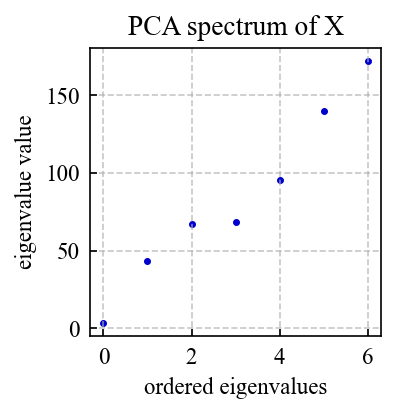

In [12]:
#2nd part of pt 1 --> pca analysis

# perform SVD decomposition of the feature matrix

U, S, V_T = np.linalg.svd(X_ft_stand[:10000,:], full_matrices=True)

plt.figure(figsize = (2.5,2.5))
plt.scatter(range(n_feat), np.sort(S), color="mediumblue", s=5.5)
plt.xlabel("ordered eigenvalues")
plt.ylabel("eigenvalue value")
plt.title("PCA spectrum of X")
#plt.xlim(24,1)
plt.grid(ls='--', alpha=0.7)
plt.show()

In [13]:
n_feat = 7

# initialize feature matrix
X_feat = np.zeros([T.size,n_feat])


# define feature matrix
for i, f in enumerate([Mmeert, sb50, grm, rim, cr, nser, ba]):
    X_feat[:,i] = f

X_ft_stand = StandardScaler().fit_transform(X_feat)

In [14]:

# "My accuracy decreased when I retrained Random Forest with just the best parameters. It is only slightly lower. 
# Maybe with more properties, the classifications are more accurate due to more ways to differentiate between objects. 
# " The accuracy estimate has an uncertainty, so when you run with different parameters or even a run with different random initialization, results can be a bit different. 
# Results for the ANN are poor, because you used standard labels instead of 1-hot-encoded ones. -2. 
# Results will be better with 1-hot-encoded labels. Good job overall.

In [15]:
#part 2

In [16]:
from sklearn.model_selection import train_test_split

n_samples = 100000

#labels_r = labels[:n_samples]

X_train, X_test, y_train, y_test = train_test_split(X_feat, labels, train_size=0.80, random_state=42)

#labels_r2 = labels2[:n_samples]

X_train, X_test, y_train2, y_test2 = train_test_split(X_feat, labels2, train_size=0.80, random_state=42)

#labels_r3 = labels3[:n_samples]

X_train, X_test, y_train3, y_test3 = train_test_split(X_feat, labels3, train_size=0.80, random_state=42)

#labels_r4 = labels4[:n_samples]

X_train, X_test, y_train4, y_test4 = train_test_split(X_feat, labels4, train_size=0.80, random_state=42)

In [17]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

# define classifier object
knn = KNeighborsClassifier(n_neighbors=20, weights='distance')

# train classifier using the training data
knn.fit(X_train, y_train)
labpred = knn.predict(X_test)

acc_knn = accuracy_score(y_test, labpred)
print("kNN accuracy = %.3f"%acc_knn)

# train classifier using the training data
knn.fit(X_train, y_train2)
labpred2 = knn.predict(X_test)

acc_knn = accuracy_score(y_test2, labpred2)
print("kNN accuracy = %.3f"%acc_knn)

# train classifier using the training data
knn.fit(X_train, y_train3)
labpred3 = knn.predict(X_test)

acc_knn = accuracy_score(y_test3, labpred3)
print("kNN accuracy = %.3f"%acc_knn)

# train classifier using the training data
knn.fit(X_train, y_train4)
labpred4 = knn.predict(X_test)

acc_knn = accuracy_score(y_test4, labpred4)
print("kNN accuracy = %.3f"%acc_knn)



kNN accuracy = 0.779
kNN accuracy = 0.888
kNN accuracy = 0.950
kNN accuracy = 0.936


In [18]:
def plot_confusion_matrix_mpl(y_test, ypred, class_names = ['galaxy', 'star', 'quasar'],
                          title=None, figsize=(3,3)):
    conf_mat = conf_matrix(y_test, ypred, class_names=class_names)
    fig, ax = plt.subplots(1, 1, figsize = figsize)
    if title is not None:
        plt.title(title, fontsize=10)
    im = heatmap(conf_mat.T, class_names, class_names, ax=ax,
                   cmap="Blues")
    txt = annotate_heatmap(im, ax=ax, class_labels=class_names,
               xticklabels=class_names,
               yticklabels=class_names)
    plt.xlabel('true label')
    plt.ylabel('predicted label')
    plt.show()

In [19]:
# from sklearn.metrics import confusion_matrix
# import seaborn as sns # to plot the confusion matrix prettier

# def conf_matrix(y_test, y_pred, class_names=None): 
#     """
#     helper function computing confusion matrix
#     """
#     conf_mat = confusion_matrix(y_test, y_pred).T
#     conf_mat = conf_mat.astype(float)

#     # normalize confusion fraction 
#     for i in range(len(class_names)):
#         conf_mat[i,:] /= float(np.sum(conf_mat[i,:])) 

#     return conf_mat

In [20]:
from sklearn.metrics import confusion_matrix
import seaborn as sns # to plot the confusion matrix prettier

def conf_matrix(y_test, y_pred, class_names=None): 
    """
    helper function computing confusion matrix
    """
    conf_mat = confusion_matrix(y_test, y_pred).T
    conf_mat = conf_mat.astype(float)

    # normalize confusion fraction 
    for i in range(len(class_names)):
        conf_mat[i,:] /= float(np.sum(conf_mat[i,:])) 

    return conf_mat



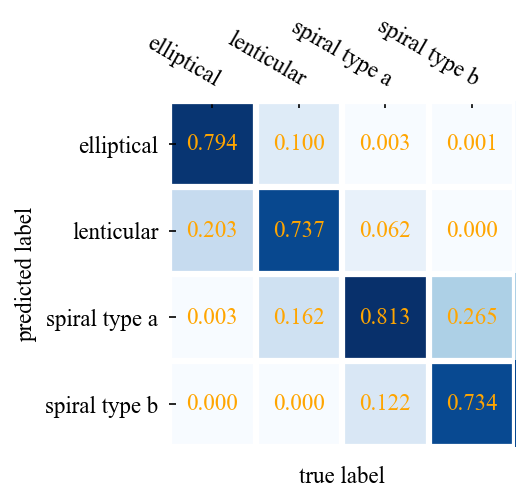

In [21]:
class_names = ['elliptical', 'lenticular', 'spiral type a','spiral type b' ]
plot_confusion_matrix_mpl(y_test,labpred, class_names=class_names)

In [22]:
from sklearn.ensemble import RandomForestClassifier

In [23]:
# create an instance of the random forest classifier
RF_cl = RandomForestClassifier(n_estimators=150, criterion='gini', max_depth=None,
                               min_samples_split=5, min_samples_leaf=1)


In [24]:
# from sklearn.metrics import accuracy_score

# def rf_classification_matrix(y_train, class_names):
#     RF_cl = RandomForestClassifier(n_estimators=150, criterion='gini', max_depth=None,
#                                min_samples_split=5, min_samples_leaf=1)
#     tstart = default_timer()
#     RF_cl.fit(X_train, y_train) # train the classifier using training sample
#     print('finished in {:.2f} sec'.format(default_timer()-tstart))
#     y_pred = RF_cl.predict(X_test)
    

#     acc_RF = accuracy_score(y_test, y_pred)

#     print('classification accuracy for test sample is {:.2f} %'.format(100.*acc_RF))

# all_class_names = [['elliptical', 'lenticular', 'spiral type a','spiral type b' ], ]

In [25]:
tstart = default_timer()
RF_cl.fit(X_train, y_train) # train the classifier using training sample
print('finished in {:.2f} sec'.format(default_timer()-tstart))

finished in 43.59 sec


In [26]:
# now predict now on the test set
y_pred = RF_cl.predict(X_test)


In [27]:
from sklearn.metrics import accuracy_score

acc_RF = accuracy_score(y_test, y_pred)

print('classification accuracy for test sample is {:.2f} %'.format(100.*acc_RF))

classification accuracy for test sample is 81.56 %


In [28]:
from sklearn.metrics import confusion_matrix
import seaborn as sns # to plot the confusion matrix prettier

def conf_matrix(y_test, y_pred, class_names=None): 
    """
    helper function computing confusion matrix
    """
    conf_mat = confusion_matrix(y_test, y_pred).T
    conf_mat = conf_mat.astype(float)

    # normalize confusion fraction 
    for i in range(len(class_names)):
        conf_mat[i,:] /= float(np.sum(conf_mat[i,:])) 

    return conf_mat



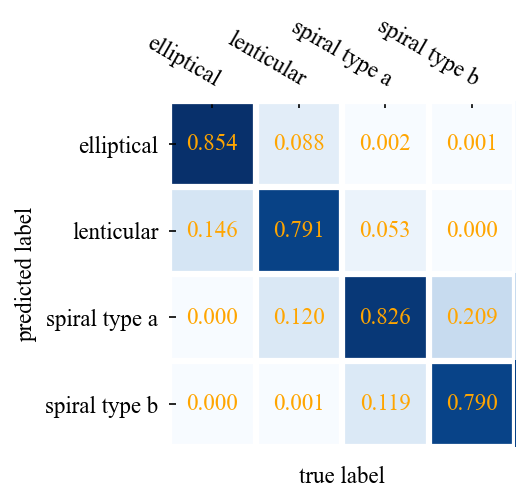

In [29]:
class_names = ['elliptical', 'lenticular', 'spiral type a', 'spiral type b' ]
plot_confusion_matrix_mpl(y_test,y_pred, class_names=class_names)

finished in 39.89 sec
classification accuracy for test sample is 91.10 %


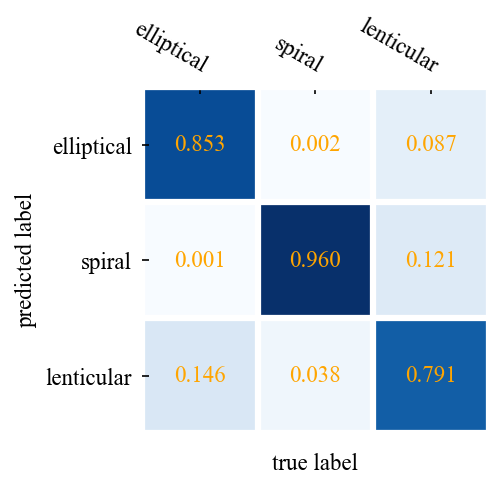

In [30]:
#I know I should probably define a function instead of doing this four times.........

tstart = default_timer()
RF_cl.fit(X_train, y_train2) # train the classifier using training sample
print('finished in {:.2f} sec'.format(default_timer()-tstart))

# now predict now on the test set
y_pred2 = RF_cl.predict(X_test)

acc_RF = accuracy_score(y_test2, y_pred2)

print('classification accuracy for test sample is {:.2f} %'.format(100.*acc_RF))


class_names2 = ['elliptical', 'spiral', 'lenticular']
plot_confusion_matrix_mpl(y_test2,y_pred2, class_names=class_names2)

finished in 36.88 sec
classification accuracy for test sample is 96.09 %


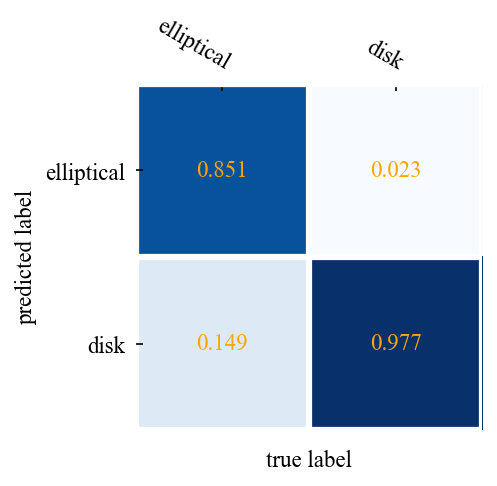

In [31]:
tstart = default_timer()
RF_cl.fit(X_train, y_train3) # train the classifier using training sample
print('finished in {:.2f} sec'.format(default_timer()-tstart))

# now predict now on the test set
y_pred3 = RF_cl.predict(X_test)

acc_RF = accuracy_score(y_test3, y_pred3)

print('classification accuracy for test sample is {:.2f} %'.format(100.*acc_RF))

class_names3 = ['elliptical', 'disk']
plot_confusion_matrix_mpl(y_test3,y_pred3, class_names=class_names3)

finished in 38.70 sec
classification accuracy for test sample is 94.79 %


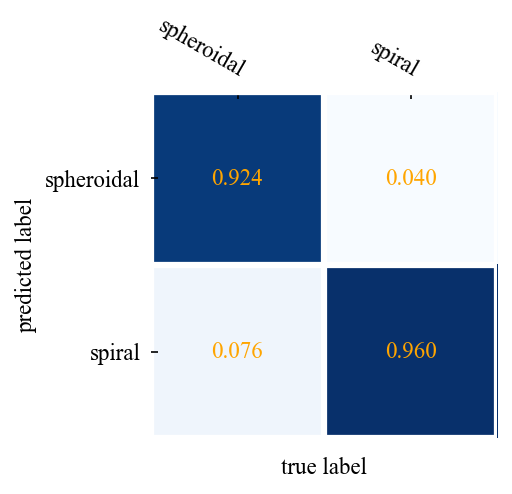

In [32]:
tstart = default_timer()
RF_cl.fit(X_train, y_train4) # train the classifier using training sample
print('finished in {:.2f} sec'.format(default_timer()-tstart))


# now predict now on the test set
y_pred4 = RF_cl.predict(X_test)

acc_RF = accuracy_score(y_test4, y_pred4)

print('classification accuracy for test sample is {:.2f} %'.format(100.*acc_RF))
class_names4 = ['spheroidal', 'spiral']
plot_confusion_matrix_mpl(y_test4,y_pred4, class_names=class_names4)

In [33]:
# from sklearn.metrics import confusion_matrix
# import seaborn as sns # to plot the confusion matrix prettier

# def conf_matrix(y_test, y_pred, class_names=None): 
#     """
#     helper function computing confusion matrix
#     """
#     conf_mat = confusion_matrix(y_test, y_pred).T
#     conf_mat = conf_mat.astype(float)

#     # normalize confusion fraction 
#     for i in range(len(class_names)):
#         conf_mat[i,:] /= float(np.sum(conf_mat[i,:])) 

#     return conf_mat

In [34]:
# # Classes 1 (relatively fine classification): Sab (spiral types a and b), Scd (spiral types c and d), S0 (lenticular galaxies), and E (elliptical).
# # Classes 2 (coarser classification): Spiral (spiral combining Sab and Scd), S0 (lenticular), and E (elliptical).
# # Classes 3 (coarse classification): D (disk galaxies, including Sab, Scd, S0) and E (elliptical).
# # Classes 4: Spiral (Sab and Sab) and Spheroidal (S0+Elliptical) galaxies

# class_names = ['elliptical', 'lenticular', 'spiral type a','spiral type b' ]
# conf_mat = conf_matrix(y_test, y_pred, class_names=class_names)

# plt.figure(figsize = (3.0,3.0))
# plt.title('Confusion Matrix - Random Forest classification',fontsize=10)
# sns.heatmap(conf_mat.T, square = True, annot=True, fmt='.3f', cmap='Blues', cbar=False, 
#            xticklabels= class_names,
#            yticklabels= class_names)

# plt.xlabel('true label')
# plt.ylabel('predicted label')
# plt.show()

In [35]:
# # Bayesian machine learning probabilities of morphological classes from Huertas-Company et al. 2011, AA 525, 157
# # probaE is probability to be early type (either E or S0); 1-probaE is probability to be spiral
# # probaEll = probability to be elliptical; probaS0 = p(S0); probaSab = p(Sa or Sb); probaScd = p(Sc, Sd, or Irr)
# pE = morph['probaE']; pEll = morph['probaEll']; pS0  = morph['probaS0']; 
# pSab = morph['probaSab']; pScd = morph['probaScd']; 

# # morphological class T is a variable that combines these probabilities 
# # into a single number that can be used to define classes
# # T fit from Meert et al. (2015)
# T = (-4.6 * pEll)-(2.4 * pS0) + (2.5*pSab) + (6.1*pScd)

# # define filters that will select galaxies of a given morphological type
# # this uses morphological type boundaries suggested in Meert et al. 2015
# ell = T <= -3
# s0 = (0.5 >= T) & (T > -3)
# sab = (4 >= T) & (T > 0.5)
# scd = T > 4


# # these filters can now be used to select properties of only galaxies of Elliptical or Spheroidal type
# # for example g-r color of elliptical galaxies can be selected as
# grm_ell = grm[ell]


# labels = np.zeros_like(T).astype('int')
# labels[s0]  = 1
# labels[sab] = 2
# labels[scd] = 3

# # one-hot bit encoding
# # labels = np.zeros((T.size,4)).astype('int')
# # labels[ell,0] = 1
# # labels[s0,1]  = 1
# # labels[sab,2] = 1
# # labels[scd,3] = 1


In [36]:
def plot_rf_importances(indices, importances, feature_names):
    # Plot the feature importances of the forest
    plt.figure(figsize=(5,2.5))
    plt.title("feature importances")
    plt.bar(feature_names[indices], importances[indices],
           color="slateblue",  align="center")
    plt.xticks(range(X_train.shape[1]), feature_names[indices], rotation=90)
    plt.xlim([-1, X_train.shape[1]])

    plt.xlabel('feature name')
    plt.ylabel('feature importance')
    plt.show()

In [37]:

importances = RF_cl.feature_importances_

indices = np.argsort(importances)[::-1]

# Print the feature ranking
print('feature ranking:')
print('-'*15)
      
for f in range(X_train.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))


feature ranking:
---------------
1. feature 5 (0.296714)
2. feature 4 (0.286808)
3. feature 6 (0.166895)
4. feature 2 (0.101094)
5. feature 1 (0.080557)
6. feature 0 (0.039945)
7. feature 3 (0.027986)


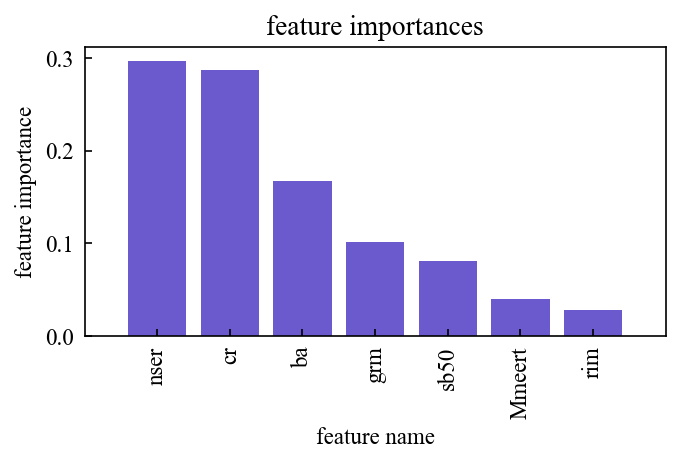

In [38]:
#property_names  = np.array(['Mmeert', 'sb50', 'grm', 'rim', 'cr', 'nser', 'ba'])
plot_rf_importances(indices, importances, property_names)


In [39]:
# I forgot to mention that for this classification problem, it is better not to scale the feature values. 
# So after you do PCA and SelectKBest, redefine 7 features (without redshift) without applying StandardScaler().fit_transform(X_feat) to them. 
# You will see that classification of galaxies will improve substantially without this scaling. 
# The same for the cases when you subselect only important features. 
# So this is not needed at the end of your Part I code (and also in other places throughout the notebook): X_ft_stand = StandardScaler().fit_transform(X_feat) 
# Please redo calculations without rescaling in the final submission. 
# Also, redo calculations for the entire sample not just for n_samples = 100000 
# "My accuracy decreased when I retrained Random Forest with just the best parameters. It is only slightly lower. 
# Maybe with more properties, the classifications are more accurate due to more ways to differentiate between objects. 
# " The accuracy estimate has an uncertainty, so when you run with different parameters or even a run with different random initialization, results can be a bit different. 
# Results for the ANN are poor, because you used standard labels instead of 1-hot-encoded ones. -2. 
# Results will be better with 1-hot-encoded labels. Good job overall.

In [40]:
#retraining random forest------------------------>

In [41]:
n_feat = 4

# initialize feature matrix
X_featb = np.zeros([T.size,n_feat])


# define feature matrix
for i, f in enumerate([grm, cr, nser, ba]):
    X_featb[:,i] = f

X_ft_standb = StandardScaler().fit_transform(X_featb)

In [42]:
from sklearn.model_selection import train_test_split

#n_samples = 100000

#labels_r = labels[:n_samples]

X_trainb, X_testb, y_trainb, y_testb = train_test_split(X_featb, labels, train_size=0.80, random_state=42)

#labels_r2 = labels2[:n_samples]

X_trainb, X_testb, y_trainb2, y_testb2 = train_test_split(X_featb, labels2, train_size=0.80, random_state=42)

#labels_r3 = labels3[:n_samples]

X_trainb, X_testb, y_trainb3, y_testb3 = train_test_split(X_featb, labels3, train_size=0.80, random_state=42)

#labels_r4 = labels4[:n_samples]

X_trainb, X_testb, y_trainb4, y_testb4 = train_test_split(X_featb, labels4, train_size=0.80, random_state=42)

In [43]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score

# define classifier object
knn = KNeighborsClassifier(n_neighbors=20, weights='distance')

# train classifier using the training data
knn.fit(X_trainb, y_trainb)
labpred = knn.predict(X_testb)

acc_knn = accuracy_score(y_testb, labpred)
print("kNN accuracy = %.3f"%acc_knn)

# train classifier using the training data
knn.fit(X_trainb, y_trainb2)
labpred2 = knn.predict(X_testb)

acc_knn = accuracy_score(y_testb2, labpred2)
print("kNN accuracy = %.3f"%acc_knn)

# train classifier using the training data
knn.fit(X_trainb, y_trainb3)
labpred3 = knn.predict(X_testb)

acc_knn = accuracy_score(y_testb3, labpred3)
print("kNN accuracy = %.3f"%acc_knn)

# train classifier using the training data
knn.fit(X_trainb, y_trainb4)
labpred4 = knn.predict(X_testb)

acc_knn = accuracy_score(y_testb4, labpred4)
print("kNN accuracy = %.3f"%acc_knn)



kNN accuracy = 0.796
kNN accuracy = 0.902
kNN accuracy = 0.958
kNN accuracy = 0.943


In [44]:
from sklearn.ensemble import RandomForestClassifier

In [45]:
# create an instance of the random forest classifier
RF_cl = RandomForestClassifier(n_estimators=150, criterion='gini', max_depth=None,
                               min_samples_split=5, min_samples_leaf=1)


In [46]:
tstart = default_timer()
RF_cl.fit(X_trainb, y_trainb) # train the classifier using training sample
print('finished in {:.2f} sec'.format(default_timer()-tstart))

finished in 44.18 sec


In [47]:
# now predict now on the test set
y_predb = RF_cl.predict(X_testb)


In [48]:
from sklearn.metrics import accuracy_score

acc_RF = accuracy_score(y_testb, y_predb)

print('classification accuracy for test sample is {:.2f} %'.format(100.*acc_RF))

classification accuracy for test sample is 79.70 %


In [49]:
from sklearn.metrics import confusion_matrix
import seaborn as sns # to plot the confusion matrix prettier

def conf_matrix(y_test, y_pred, class_names=None): 
    """
    helper function computing confusion matrix
    """
    conf_mat = confusion_matrix(y_test, y_pred).T
    conf_mat = conf_mat.astype(float)

    # normalize confusion fraction 
    for i in range(len(class_names)):
        conf_mat[i,:] /= float(np.sum(conf_mat[i,:])) 

    return conf_mat



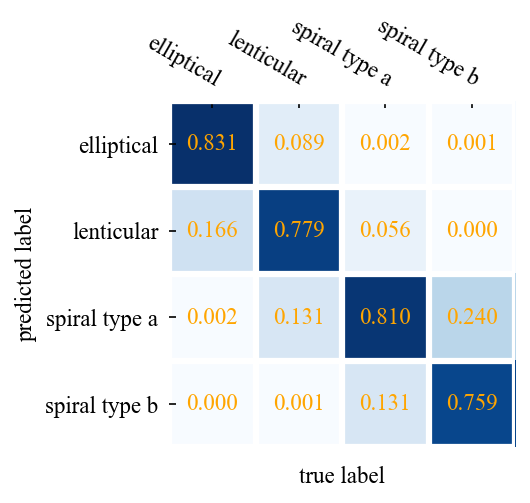

In [50]:
class_names = ['elliptical', 'lenticular', 'spiral type a', 'spiral type b' ]
plot_confusion_matrix_mpl(y_testb,y_predb, class_names=class_names)

finished in 41.99 sec
classification accuracy for test sample is 90.41 %


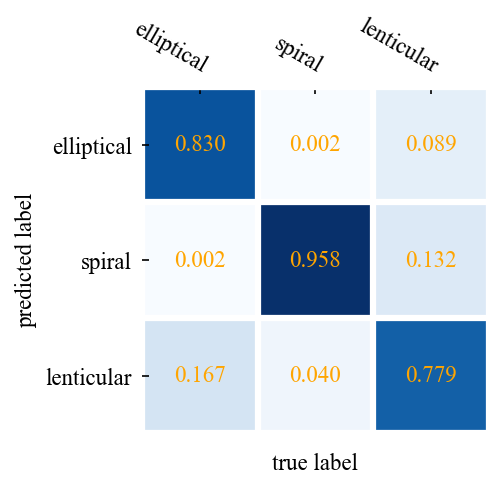

In [51]:

tstart = default_timer()
RF_cl.fit(X_trainb, y_trainb2) # train the classifier using training sample
print('finished in {:.2f} sec'.format(default_timer()-tstart))

# now predict now on the test set
y_predb2 = RF_cl.predict(X_testb)

acc_RF = accuracy_score(y_testb2, y_predb2)

print('classification accuracy for test sample is {:.2f} %'.format(100.*acc_RF))


class_names2 = ['elliptical', 'spiral', 'lenticular']
plot_confusion_matrix_mpl(y_testb2,y_predb2, class_names=class_names2)

In [52]:
#Accuracy improved the second time around without rescaling. The accuracy improved with the best parameters. 

In [ ]:
from sklearn.model_selection import GridSearchCV
param_grid = {'n_estimators': [10, 100, 150],
              'min_samples_split': [2,5,10]}

RF_cl = RandomForestClassifier(n_estimators=100, criterion='gini', max_depth=None,
                               min_samples_split=2, min_samples_leaf=1)

grid = GridSearchCV(RF_cl, param_grid, cv=3)

tstart = default_timer()
grid.fit(X_trainb, y_trainb)
print('completed in {:.2f} sec'.format(default_timer()-tstart))
print(' ')
print('best parameters are:')
print(grid.best_params_)

In [65]:
n_feat = 4

# initialize feature matrix
X_feato = np.zeros([T.size,n_feat])


# define feature matrix
for i, f in enumerate([grm, cr, nser, ba]):
    X_feato[:,i] = f

X_ft_stando = StandardScaler().fit_transform(X_feato)

In [66]:
from sklearn.model_selection import train_test_split

#n_samples = 100000

#labels_r = labels[:n_samples]

X_traino, X_testo, y_traino, y_testo = train_test_split(X_feato, labels_1h, train_size=0.80, random_state=42)

#labels_r2 = labels2[:n_samples]

X_traino, X_testo, y_traino2, y_testo2 = train_test_split(X_feato, labels_1h2, train_size=0.80, random_state=42)

#labels_r3 = labels3[:n_samples]

X_traino, X_testo, y_traino3, y_testo3 = train_test_split(X_feato, labels_1h3, train_size=0.80, random_state=42)

#labels_r4 = labels4[:n_samples]

X_traino, X_testo, y_traino4, y_testo4 = train_test_split(X_feato, labels_1h4, train_size=0.80, random_state=42)

In [67]:
from time import time
from sklearn.neural_network import MLPClassifier

tstart = time()
# initialize the neural network
mlp = MLPClassifier(max_iter=20, alpha=1.e-4, solver='sgd',
                    random_state=1, learning_rate_init=0.1,
                    verbose=10,
                    hidden_layer_sizes=(5,100,10))

# train neural network
mlp.fit(X_traino, y_traino)

print('completed in {:.2f} sec'.format(time()-tstart))

Iteration 1, loss = 1.51276882
Iteration 2, loss = 1.34263848
Iteration 3, loss = 1.29556834
Iteration 4, loss = 1.27680442
Iteration 5, loss = 1.26750750
Iteration 6, loss = 1.25805186
Iteration 7, loss = 1.25773192
Iteration 8, loss = 1.25592364
Iteration 9, loss = 1.25089060
Iteration 10, loss = 1.25374625
Iteration 11, loss = 1.25492533
Iteration 12, loss = 1.25102271
Iteration 13, loss = 1.24957888
Iteration 14, loss = 1.24917018
Iteration 15, loss = 1.24769393
Iteration 16, loss = 1.24624119
Iteration 17, loss = 1.24596562
Iteration 18, loss = 1.24831420
Iteration 19, loss = 1.24643012
Iteration 20, loss = 1.24624525
completed in 3.77 sec


/Users/khadarty/miniconda3/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (20) reached and the optimization hasn't converged yet.
  warnings.warn(


In [69]:
from sklearn.metrics import accuracy_score

# fraction of correct predictions for the training sample images
train_acc = 100. * accuracy_score(y_traino, mlp.predict(X_traino))

# fraction of correct predictions for the test sample images
test_acc = 100.*accuracy_score(y_testo, mlp.predict(X_testo))

print(f'Accuracy on the training data is {train_acc:.2f}%')
print(f'Accuracy on the test data is {test_acc:.2f}%')

Accuracy on the training data is 51.75%
Accuracy on the test data is 52.02%


In [70]:
#accuracy decreased to 50% when i tried to use one-hot encoding, not sure what i did wrong

In [71]:
class_names = ['elliptical', 'lenticular', 'spiral type a','spiral type b' ]
plot_confusion_matrix_mpl(y_testo,mlp.predict(X_testo), class_names=class_names)

ValueError: multilabel-indicator is not supported

In [72]:
from time import time
from sklearn.neural_network import MLPClassifier

tstart = time()
# initialize the neural network
mlp = MLPClassifier(max_iter=20, alpha=1.e-4, solver='sgd',
                    random_state=1, learning_rate_init=0.1,
                    verbose=10,
                    hidden_layer_sizes=(5,100,10))

# train neural network
mlp.fit(X_trainb, y_trainb)

print('completed in {:.2f} sec'.format(time()-tstart))

Iteration 1, loss = 0.91403369
Iteration 2, loss = 0.95442484
Iteration 3, loss = 0.71928424
Iteration 4, loss = 0.60972724
Iteration 5, loss = 0.57671024
Iteration 6, loss = 0.56951098
Iteration 7, loss = 0.56612194
Iteration 8, loss = 0.56467900
Iteration 9, loss = 0.56244566
Iteration 10, loss = 0.56090576
Iteration 11, loss = 0.56277894
Iteration 12, loss = 0.56043133
Iteration 13, loss = 0.56035816
Iteration 14, loss = 0.55718346
Iteration 15, loss = 0.56034407
Iteration 16, loss = 0.55668002
Iteration 17, loss = 0.55771146
Iteration 18, loss = 0.55587968
Iteration 19, loss = 0.55724942
Iteration 20, loss = 0.55852237
completed in 3.76 sec


/Users/khadarty/miniconda3/lib/python3.10/site-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (20) reached and the optimization hasn't converged yet.
  warnings.warn(


In [73]:
from sklearn.metrics import accuracy_score

# fraction of correct predictions for the training sample images
train_acc = 100. * accuracy_score(y_trainb, mlp.predict(X_trainb))

# fraction of correct predictions for the test sample images
test_acc = 100.*accuracy_score(y_testb, mlp.predict(X_testb))

print(f'Accuracy on the training data is {train_acc:.2f}%')
print(f'Accuracy on the test data is {test_acc:.2f}%')

Accuracy on the training data is 75.22%
Accuracy on the test data is 75.08%


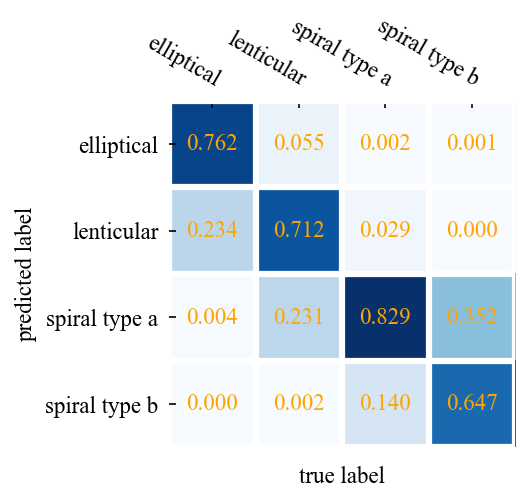

In [74]:
class_names = ['elliptical', 'lenticular', 'spiral type a','spiral type b' ]
plot_confusion_matrix_mpl(y_testb,mlp.predict(X_testb), class_names=class_names)

In [ ]:
#This method is better at classifying elliptical and spiral type galaxies. It is much faster than methods previously used. 

### <font color='blue'>Visualizing random subsets of SDSS galaxies as a gallery of images</font>

Functions to query SDSS server and pull out images of a subset of galaxies using their coordinates and objectid and display them on a grid. You can use these to visualize galaxies classified into different classes for a visual check. 
    
Create a subdirectories <tt>fig/</tt> and <tt>sdss_img/</tt> in the directory where this notebook is run before you run these functions.

In [ ]:
import os
import urllib
from io import StringIO
from PIL import Image
import requests
from io import BytesIO

def fetch_sdss_image(outfile, RA, DEC, scale=0.2, width=400, height=400):
    """Fetch the image at the given RA, DEC from the SDSS server"""
    with requests.get("http://skyservice.pha.jhu.edu/DR8/ImgCutout/"
           "getjpeg.aspx?ra=%.8f&dec=%.8f&scale=%.2f&width=%i&height=%i"
           % (RA, DEC, scale, width, height)) as response: 
        im = Image.open(BytesIO(response.content))
        
    # uncomment for debugging if needed
    #print "downloading %s" % url
    #print " -> %s" % outfile
    #fd = StringIO(url)
    #im = Image.open(fd)
    im.save(outfile)

def sdss_img_collage(objs, ras, decs, nrow, ncol, npix, scale, savefig=None):
    from PIL import Image
    fig, axs = plt.subplots(nrow, ncol, figsize=(ncol, nrow))

    # Check that PIL is installed for jpg support
    if 'jpg' not in fig.canvas.get_supported_filetypes():
        raise ValueError("PIL required to load SDSS jpeg images")

    for _obj, ra, dec, ax in zip(objs, ras, decs, axs.flatten()):
        ax.xaxis.set_visible(False)
        ax.yaxis.set_visible(False)
        outfile = 'sdss_img/'+str(_obj)+'.jpg'
        fetch_sdss_image(outfile, ra, dec, scale=scale, width=npix, height=npix)
        I = Image.open(outfile)
        ax.imshow(I,origin='lower')
        ax.set_aspect('auto')

    #plt.tight_layout()
    fig.subplots_adjust(hspace=0, wspace=0)
    if savefig != None:
        plt.savefig(savefig,bbox_inches='tight')
    plt.show()
    
def display_random_galaxies(rdata, nrow, ncol, npix=130, scale=0.5, savefig=None):
    # select a random subset of galaxies from the selected subset
    iran = np.unique(np.random.randint(0, np.size(rdata)-1, 2*nrow*ncol))

    # get data for the randomly selected galaxies
    dshow = rdata[iran]
    objs = dshow['objid']; ras = dshow['ra']; decs = dshow['dec']
    sdss_img_collage(objs, ras, decs, nrow, ncol, npix, scale=0.5, savefig=savefig )
    return

In [54]:
print(d_Lm.min(), d_Lm.max())

43.22831343943222 460.2968402965116


Ell 0


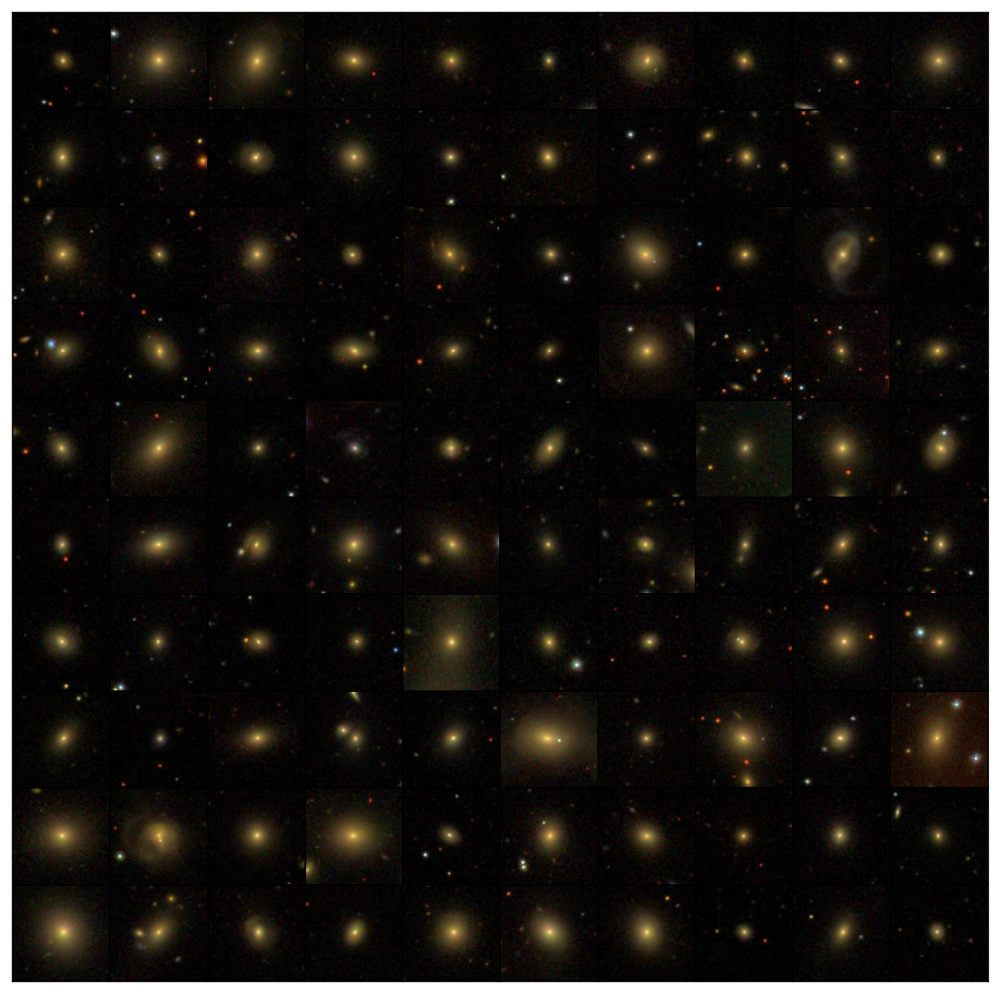

Ell 1


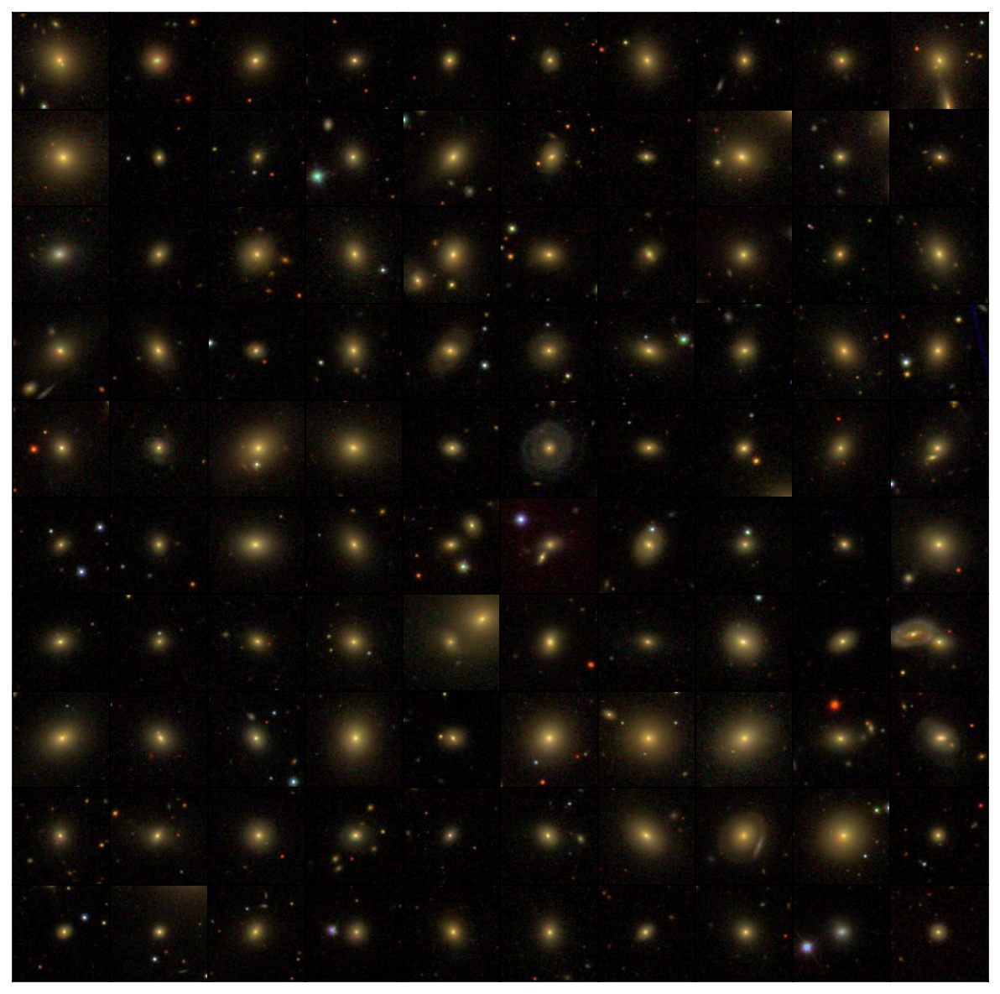

Ell 2


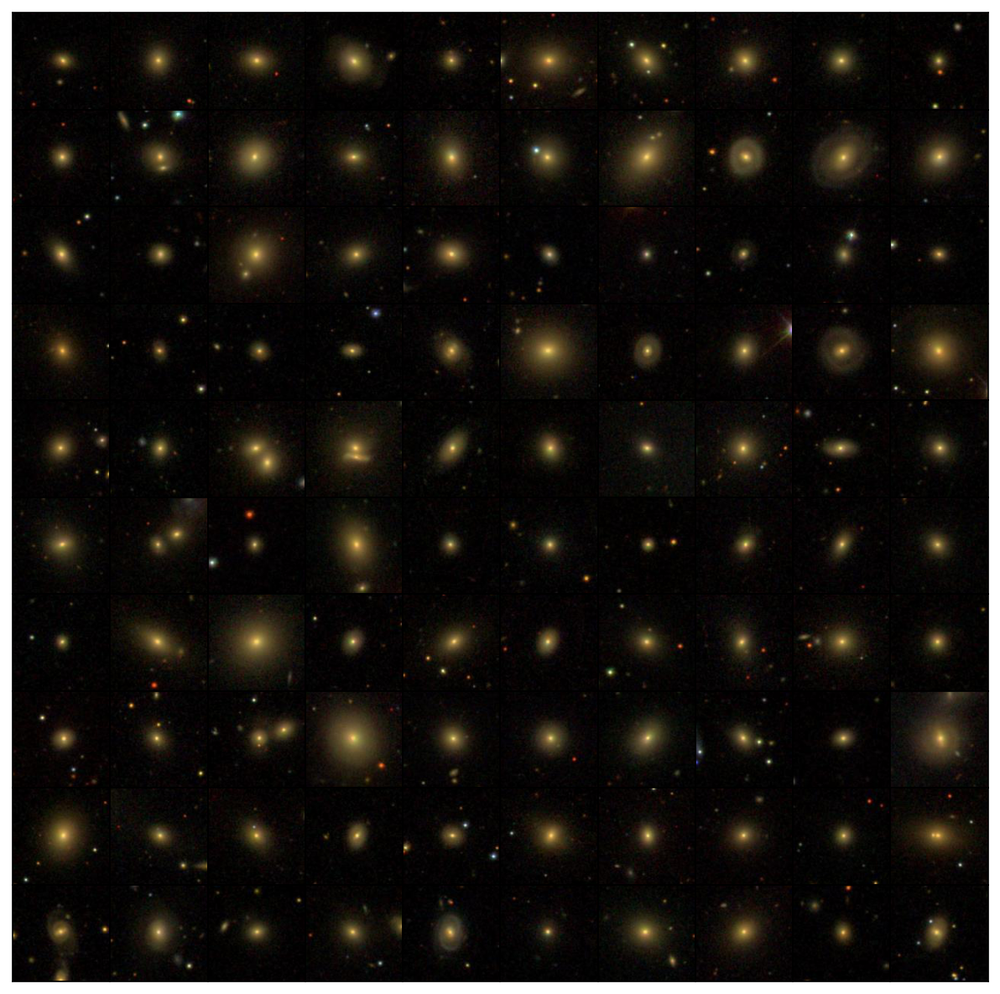

In [55]:
# use jupyter "magic" command to tell it to embed plot into the notebook 
import matplotlib.pyplot as plt
%matplotlib inline


# the number of rows and columns in the image gallery
nrow = 10; ncol = 10
# pixel size of the thumbnails to extract from the SDSS
npix = 130

# minimum and maximum luminosity distances for galaxy selection
Dmin = 100.; Dmax = 300.; 
# absolute magnitude limit on the faint end
Mlim = -19.0
Pmorphlim = 0.6

# select galaxies with these distance and absolute magnitude limits
MDsel = (Mmeert < Mlim) & (d_Lm > Dmin) & (d_Lm < Dmax)
Ellp = (pEll>Pmorphlim) & (pEll>pS0) & (pEll>pSab) & (pEll>pScd) 
S0p  = ((pS0>Pmorphlim) & (pS0>pEll) & (pS0>pSab) & (pS0>pScd))
Sabp = ((pSab>Pmorphlim) & (pSab>pEll) & (pSab>pS0) & (pSab>pScd))
Scdp = ((pScd>Pmorphlim) &(pScd>pEll) & (pScd>pS0) & (pScd>pSab))
EllT = (T<=-3) # Ell
S0T  = (0.5 >= T) & (T > -3) # S0
SabT = (4 >= T) & (T > 0.5) # Sab
ScdT = T > 4

rdata = sd[MDsel & Ellp]
for i in range(3):
    print("Ell %d"%i)
    display_random_galaxies(rdata, nrow=nrow, ncol=ncol, npix=npix, scale=0.5, savefig='fig/Ellp_M19_Dmin500_Dmax1000_%d.png'%i)

#one-hot encoding

S0 0


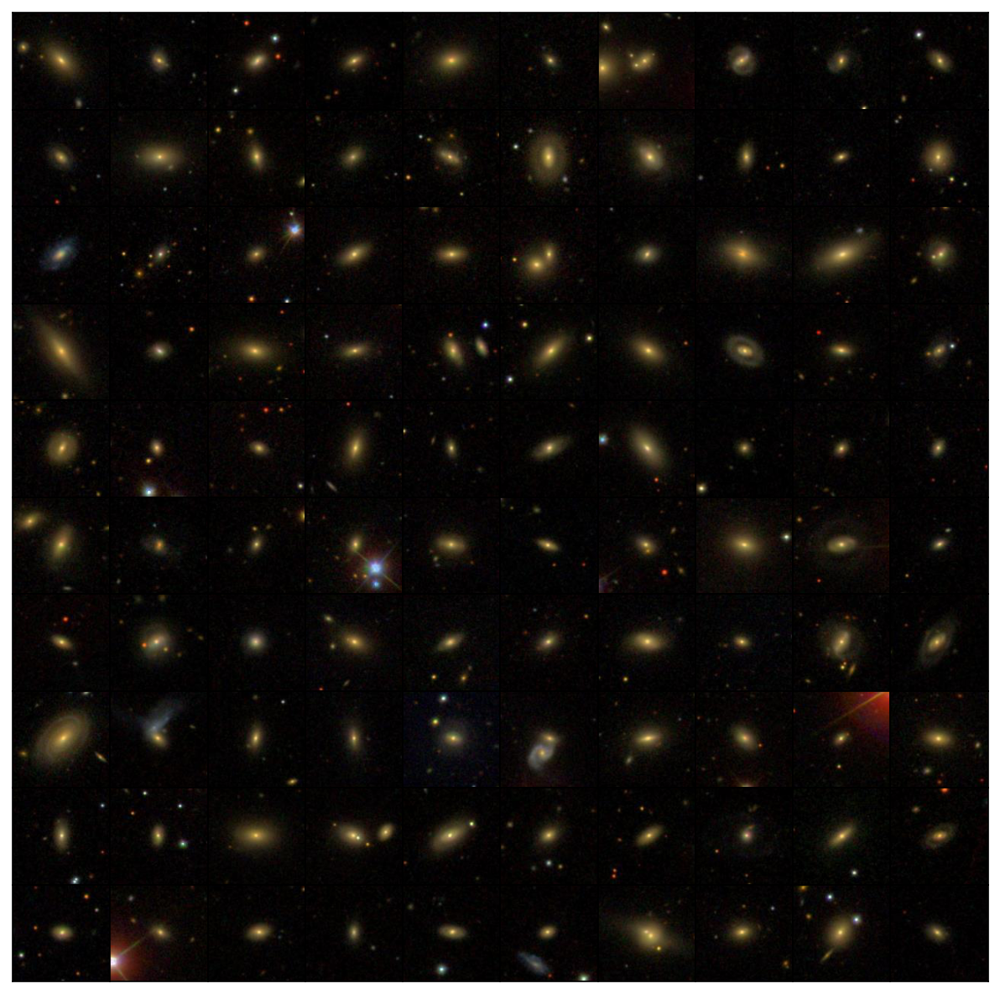

S0 1


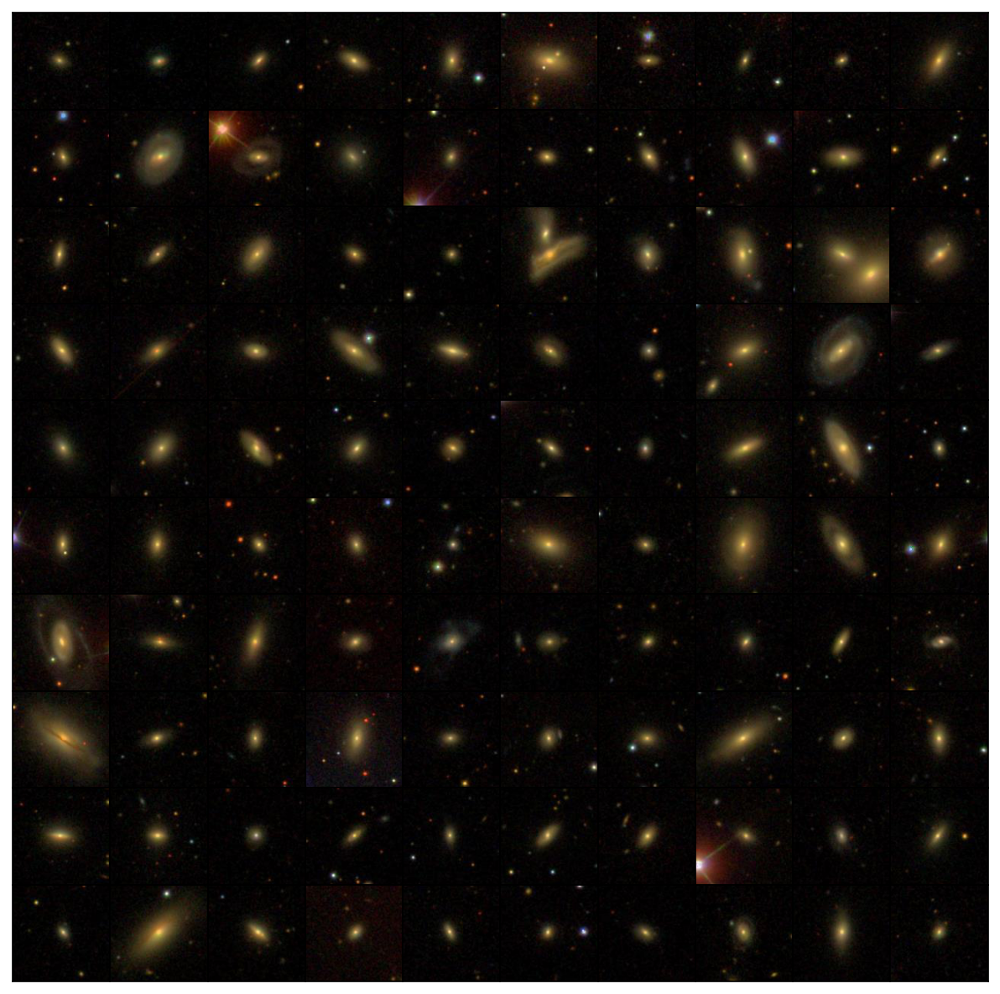

S0 2


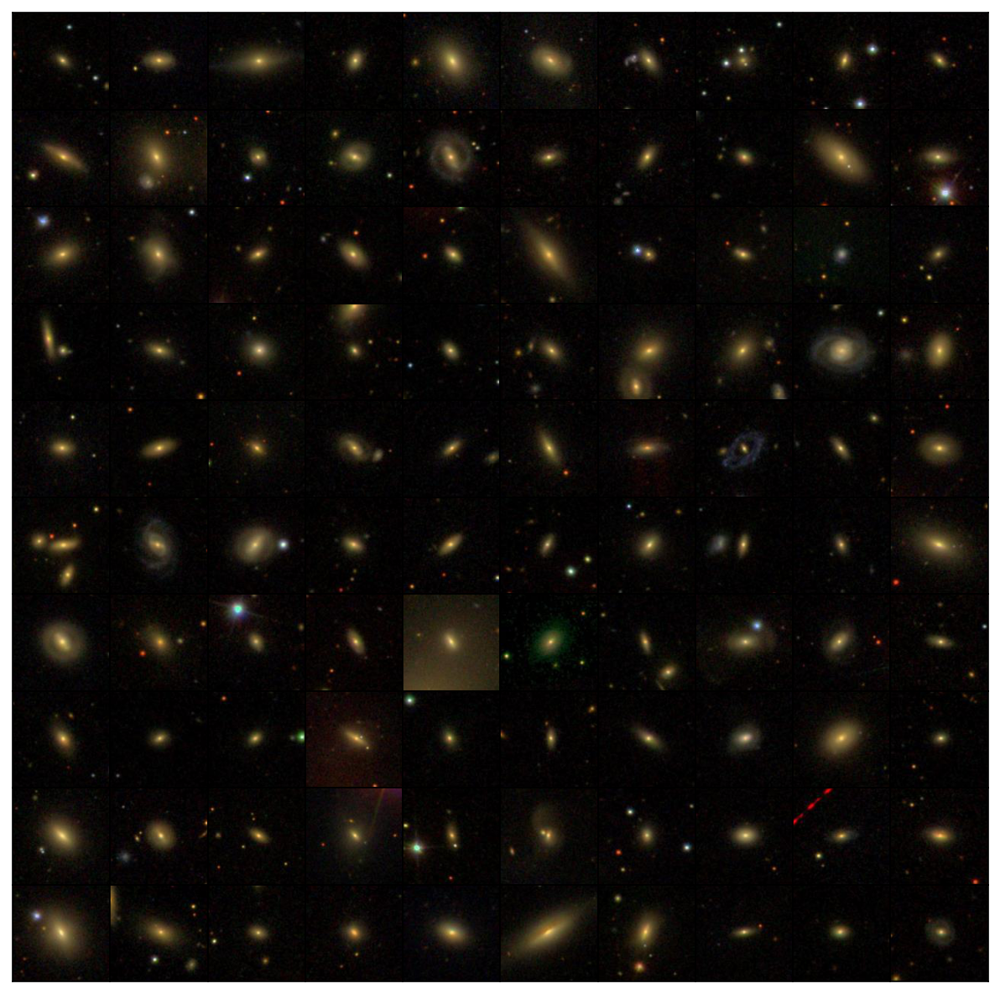

In [56]:
rdata = sd[MDsel & S0p]
for i in range(3):
    print("S0 %d"%i)
    display_random_galaxies(rdata, nrow=nrow, ncol=ncol, npix=npix, scale=0.5, savefig='fig/S0p_M19_Dmin500_Dmax1000_%d.png'%i)
    

Sab 0


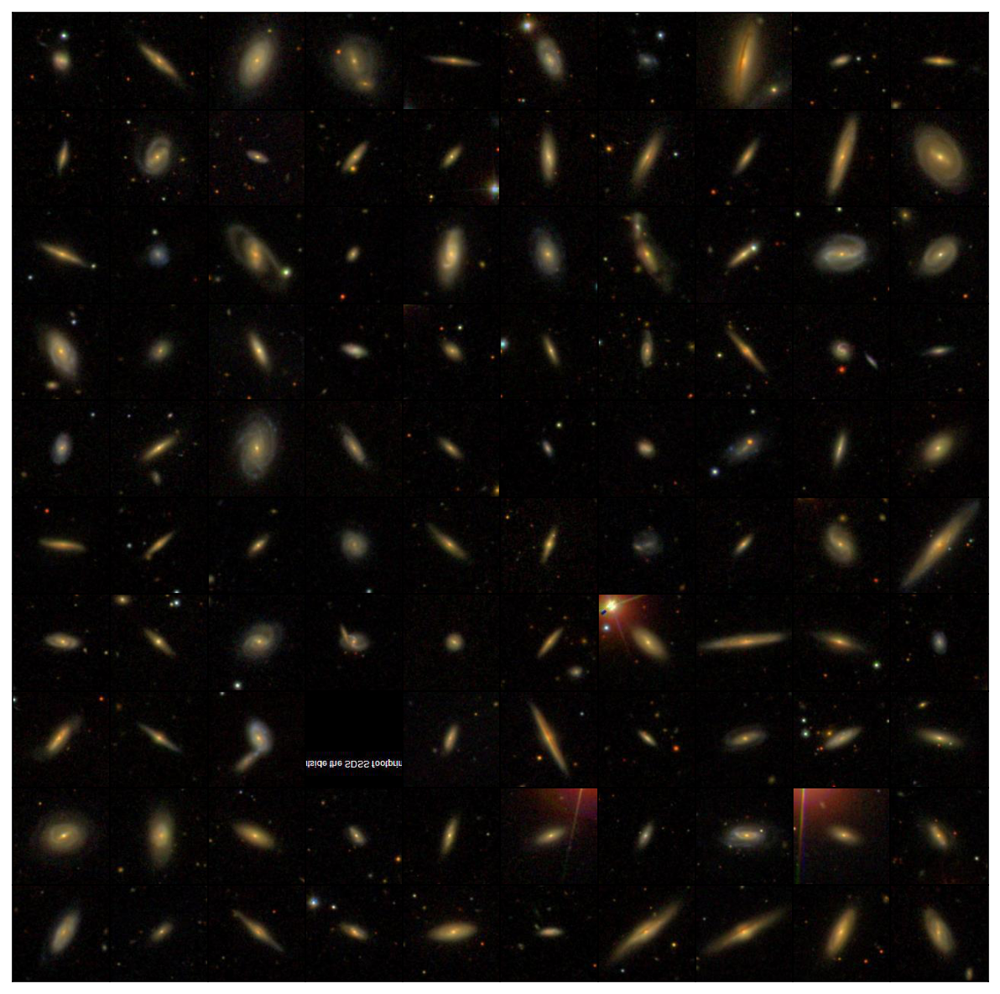

Sab 1


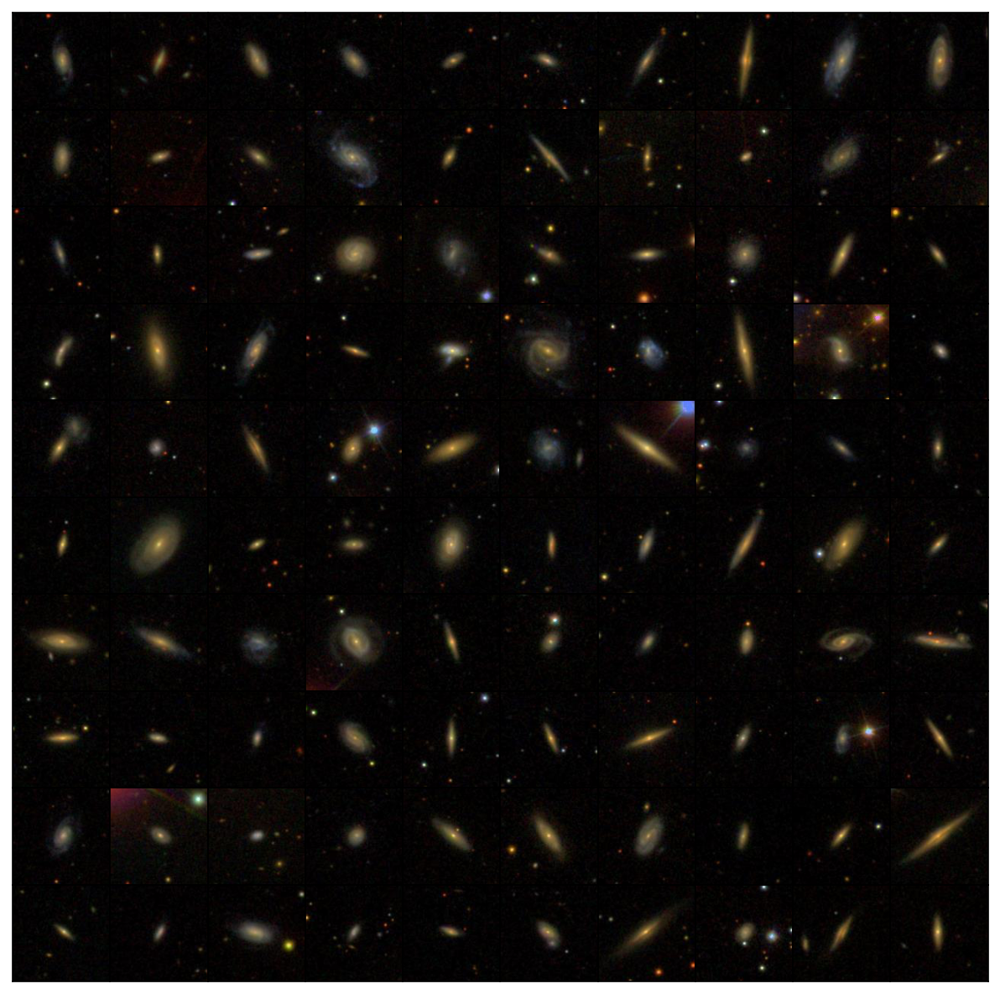

Sab 2


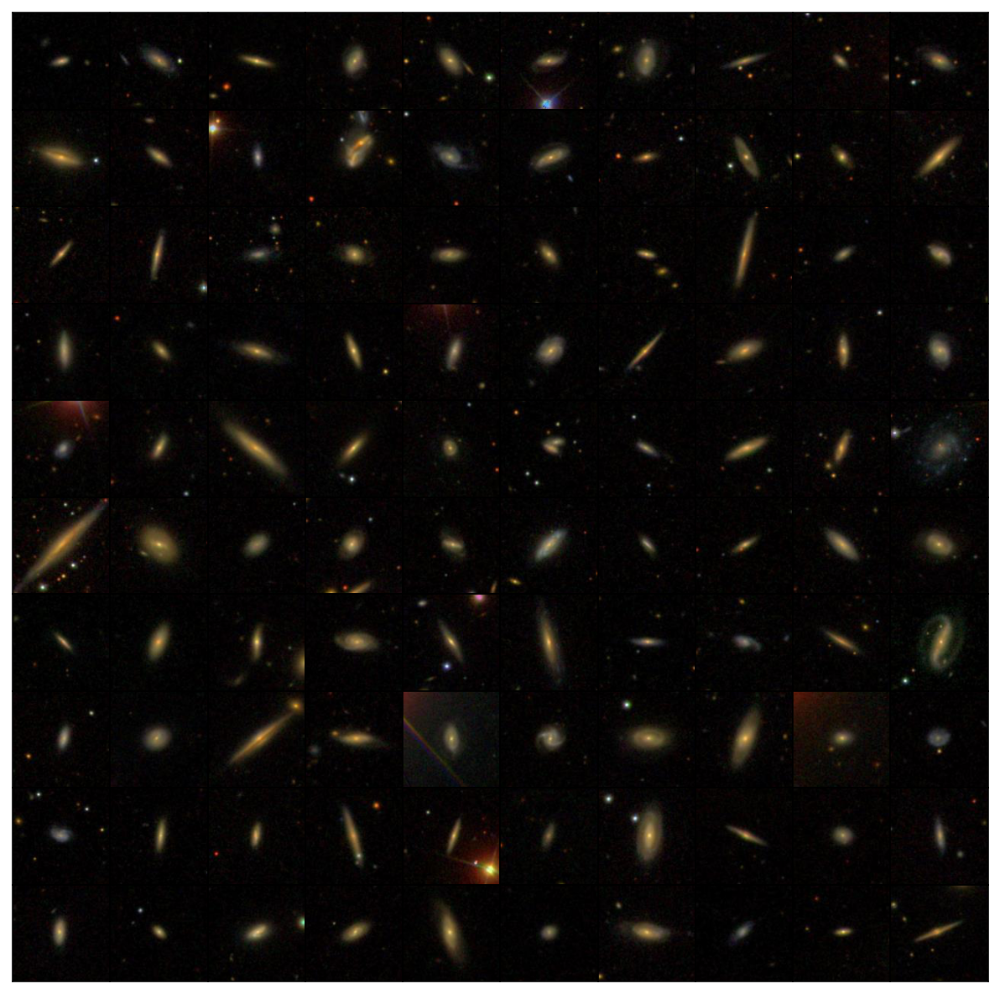

In [57]:
rdata = sd[MDsel & Sabp]
for i in range(3):
    print("Sab %d"%i)
    display_random_galaxies(rdata, nrow=nrow, ncol=ncol, npix=npix, scale=0.5, savefig='fig/Sabp_M19_Dmin500_Dmax1000_%d.png'%i)


Scd 0


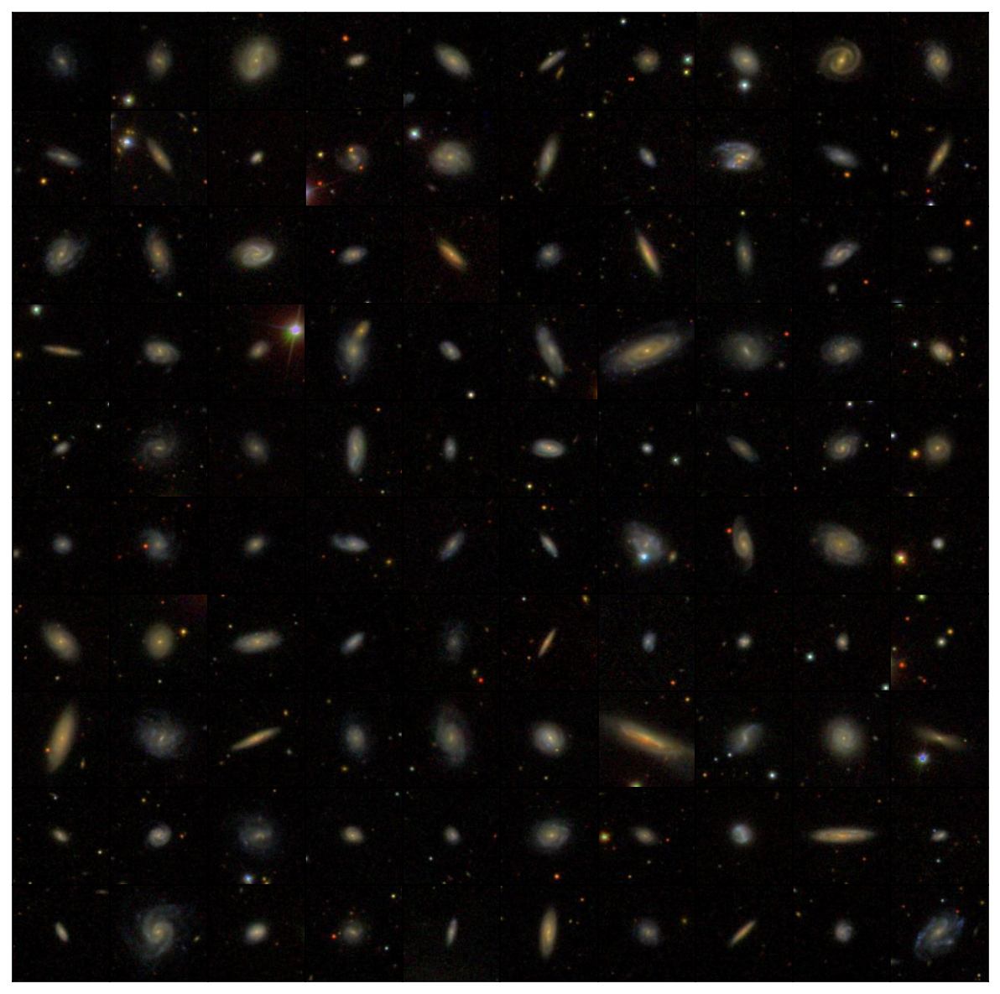

Scd 1


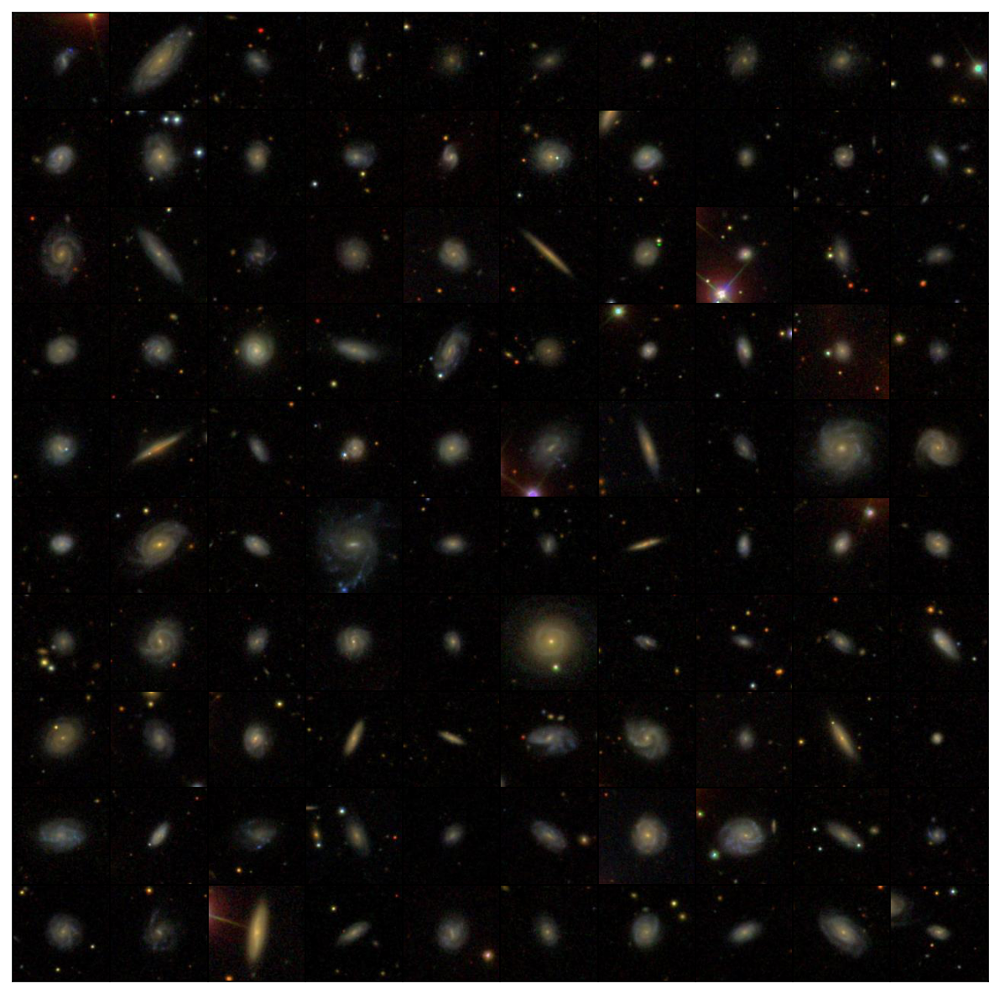

Scd 2


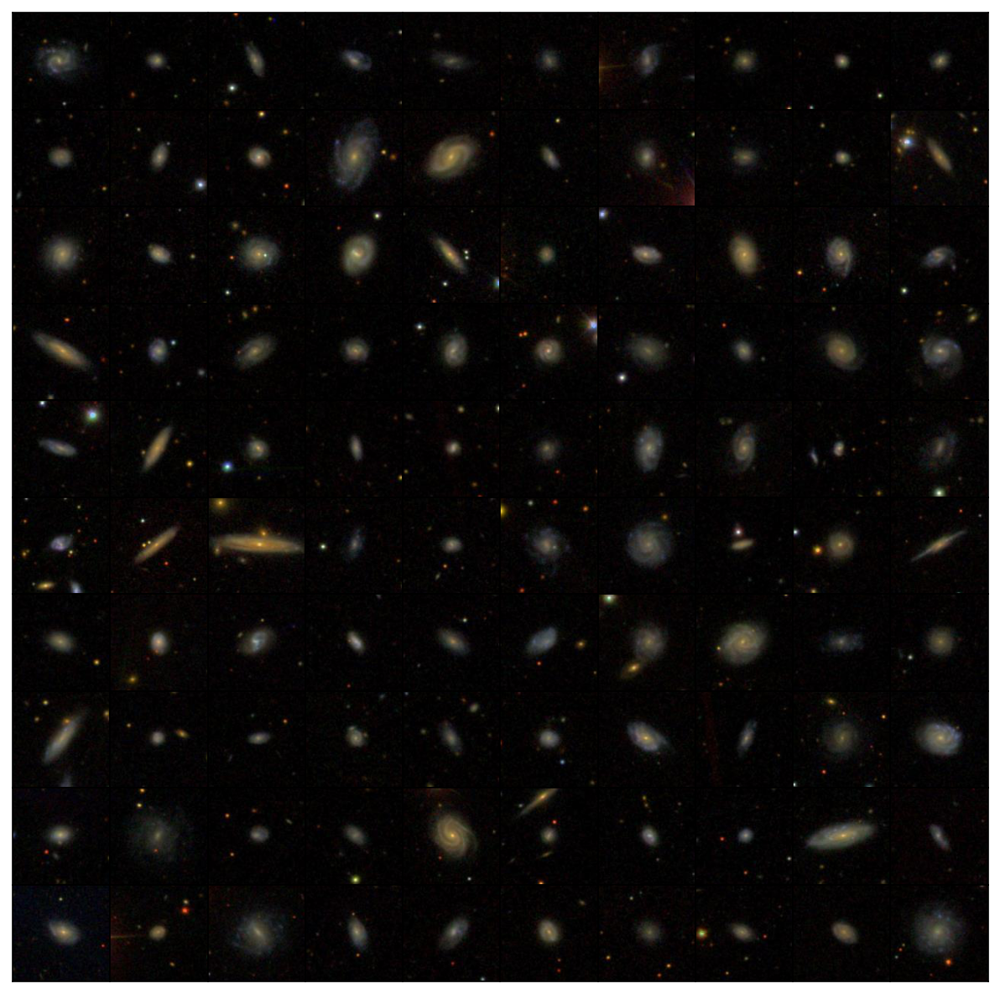

In [58]:
rdata = sd[MDsel & Scdp]
for i in range(3):
    print("Scd %d"%i)
    display_random_galaxies(rdata, nrow=nrow, ncol=ncol, npix=npix, scale=0.5, savefig='fig/Scdp_M19_Dmin500_Dmax1000_%d.png'%i)
